# Project: Wrangling and Analyze Data

In [1]:
# Importing the necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import requests
import os
import json
import csv
import tweepy
from tweepy import OAuthHandler
from timeit import default_timer as timer

#display outputs inline
%matplotlib inline

### to see all columns and rows to use the display max column parameter
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
# set the display colwitdth for seeing the entire text contents
pd.set_option('display.max_colwidth', -1)

C:\Users\LEOCLI~1\AppData\Local\Temp/ipykernel_11372/2044738227.py:21: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


## Data Gathering

In [2]:
# Downloading the WeRateDogs Twitter archive data (twitter_archive_enhanced.csv)
tweet_arch = pd.read_csv('twitter-archive-enhanced.csv')

2. Use the Requests library to download the tweet image prediction (image_predictions.tsv)

In [3]:
# Downloading the tweet image predictions from the provided url
#folder_name = 'img_pred'
#if not os.path.exists(unhashable type: 'list'unhashable type: 'list'folder_name):
    #os.makedirs(folder_name)
#url = 'https://d17h27t6h515a5.cloudfront.net/topher/2017/August/599fd2ad_image-predictions/image-predictions.tsv'
#response = requests.get(url)
#with open(os.path.join(folder_name, url.split('/')[-1]), mode='wb') as file:
          #file.write(response.content)         

In [4]:
# Read the image prediction tsv data into a dataframe
img_pred = pd.read_csv('img_pred/image-predictions.tsv', sep='\t')

3. Use the Tweepy library to query additional data via the Twitter API (tweet_json.txt)

In [5]:
# With the tweepy library query the Twitter API
#consumer_key = '******************************'
#consumer_secret = '###############################'
#access_token = '+++++++++++++++++++++++++++++++++++++++'
#access_secret = '======================================='
#auth = OAuthHandler(consumer_key, consumer_secret)
#auth.set_access_token(access_token, access_secret)
#api = tweepy.API(auth, wait_on_rate_limit=True)

In [6]:
# Fetch tweets from the twitter API
#tweet_ids = df['tweet_id'].values
#tweet = []
#fail_dicts = []
#for tweet_id in tweet_ids:
    #try:
        #tweet.append(api.get_status(tweet_id))
    #except Exception as e:
        #fail_dicts.append(tweet_id)

In [7]:
# Creating tweet_json from json file.
#tweet_json = []
#for i in tweet:
    #tweet_json.append(i._json)
#with open('tweet_json.txt', 'w') as outfile:
    #outfile.write(json.dumps(tweet_json, indent=4))

In [8]:
# Read tweet_json.txt into a pandas dataframe
tweet_data = []
with open('tweet_json.txt', encoding='utf-8') as file:
    all_data = json.load(file)
    for data in all_data:
        tweet_id = data['id']
        retweet_count = data['retweet_count']
        favorite_count = data['favorite_count']
        tweet_data.append({'tweet_id':tweet_id,
                          'retweet_count':retweet_count,
                          'favorite_count':favorite_count
                          })
tweet_df = pd.DataFrame(tweet_data, columns=['tweet_id','retweet_count','favorite_count'])

## Assessing Data
In this section, detect and document at least **eight (8) quality issues and two (2) tidiness issue**. You must use **both** visual assessment
programmatic assessement to assess the data.

**Note:** pay attention to the following key points when you access the data.

* You only want original ratings (no retweets) that have images. Though there are 5000+ tweets in the dataset, not all are dog ratings and some are retweets.
* Assessing and cleaning the entire dataset completely would require a lot of time, and is not necessary to practice and demonstrate your skills in data wrangling. Therefore, the requirements of this project are only to assess and clean at least 8 quality issues and at least 2 tidiness issues in this dataset.
* The fact that the rating numerators are greater than the denominators does not need to be cleaned. This [unique rating system](http://knowyourmeme.com/memes/theyre-good-dogs-brent) is a big part of the popularity of WeRateDogs.
* You do not need to gather the tweets beyond August 1st, 2017. You can, but note that you won't be able to gather the image predictions for these tweets since you don't have access to the algorithm used.



### Visual Assessment

In [9]:
# access the tweet arch data manually
tweet_arch

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
0,892420643555336193,NaN,NaN,2017-08-01 16:23:56 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU,NaN,NaN,NaN,https://twitter.com/dog_rates/status/892420643555336193/photo/1,13,10,Phineas,None,None,None,None
1,892177421306343426,NaN,NaN,2017-08-01 00:17:27 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10 https://t.co/0Xxu71qeIV",NaN,NaN,NaN,https://twitter.com/dog_rates/status/892177421306343426/photo/1,13,10,Tilly,None,None,None,None
2,891815181378084864,NaN,NaN,2017-07-31 00:18:03 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Archie. He is a rare Norwegian Pouncing Corgo. Lives in the tall grass. You never know when one may strike. 12/10 https://t.co/wUnZnhtVJB,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891815181378084864/photo/1,12,10,Archie,None,None,None,None
3,891689557279858688,NaN,NaN,2017-07-30 15:58:51 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Darla. She commenced a snooze mid meal. 13/10 happens to the best of us https://t.co/tD36da7qLQ,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891689557279858688/photo/1,13,10,Darla,None,None,None,None
4,891327558926688256,NaN,NaN,2017-07-29 16:00:24 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Franklin. He would like you to stop calling him ""cute."" He is a very fierce shark and should be respected as such. 12/10 #BarkWeek https://t.co/AtUZn91f7f",NaN,NaN,NaN,"https://twitter.com/dog_rates/status/891327558926688256/photo/1,https://twitter.com/dog_rates/status/891327558926688256/photo/1",12,10,Franklin,None,None,None,None
5,891087950875897856,NaN,NaN,2017-07-29 00:08:17 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here we have a majestic great white breaching off South Africa's coast. Absolutely h*ckin breathtaking. 13/10 (IG: tucker_marlo) #BarkWeek https://t.co/kQ04fDDRmh,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891087950875897856/photo/1,13,10,None,None,None,None,None
6,890971913173991426,NaN,NaN,2017-07-28 16:27:12 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Meet Jax. He enjoys ice cream so much he gets nervous around it. 13/10 help Jax enjoy more things by clicking below\n\nhttps://t.co/Zr4hWfAs1H https://t.co/tVJBRMnhxl,NaN,NaN,NaN,"https://gofundme.com/ydvmve-surgery-for-jax,https://twitter.com/dog_rates/status/890971913173991426/photo/1",13,10,Jax,None,None,None,None
7,890729181411237888,NaN,NaN,2017-07-28 00:22:40 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",When you watch your owner call another dog a good boy but then they turn back to you and say you're a great boy. 13/10 https://t.co/v0nONBcwxq,NaN,NaN,NaN,"https://twitter.com/dog_rates/status/890729181411237888/photo/1,https://twitter.com/dog_rates/status/890729181411237888/photo/1",13,10,None,None,None,None,None
8,890609185150312448,NaN,NaN,2017-07-27 16:25:51 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Zoey. She doesn't want to be one of the scary sharks. Just wants to be a snuggly pettable boatpet. 13/10 #BarkWeek https://t.co/9TwLuAGH0b,NaN,NaN,NaN,https://twitter.com/dog_rates/status/890609185150312448/photo/1,13,10,Zoey,None,None,None,None
9,89024025534

### Report
- Lots nan values
- the source column isnt easily human readable
- the dog stages columns(doggo,floofer,puppo and pupper) are almost empty

In [10]:
# access the img_pred data manually
img_pred

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
0,666020888022790149,https://pbs.twimg.com/media/CT4udn0WwAA0aMy.jpg,1,Welsh_springer_spaniel,0.465074,True,collie,1.566650e-01,True,Shetland_sheepdog,6.142850e-02,True
1,666029285002620928,https://pbs.twimg.com/media/CT42GRgUYAA5iDo.jpg,1,redbone,0.506826,True,miniature_pinscher,7.419170e-02,True,Rhodesian_ridgeback,7.201000e-02,True
2,666033412701032449,https://pbs.twimg.com/media/CT4521TWwAEvMyu.jpg,1,German_shepherd,0.596461,True,malinois,1.385840e-01,True,bloodhound,1.161970e-01,True
3,666044226329800704,https://pbs.twimg.com/media/CT5Dr8HUEAA-lEu.jpg,1,Rhodesian_ridgeback,0.408143,True,redbone,3.606870e-01,True,miniature_pinscher,2.227520e-01,True
4,666049248165822465,https://pbs.twimg.com/media/CT5IQmsXIAAKY4A.jpg,1,miniature_pinscher,0.560311,True,Rottweiler,2.436820e-01,True,Doberman,1.546290e-01,True
5,666050758794694657,https://pbs.twimg.com/media/CT5Jof1WUAEuVxN.jpg,1,Bernese_mountain_dog,0.651137,True,English_springer,2.637880e-01,True,Greater_Swiss_Mountain_dog,1.619920e-02,True
6,666051853826850816,https://pbs.twimg.com/media/CT5KoJ1WoAAJash.jpg,1,box_turtle,0.933012,False,mud_turtle,4.588540e-02,False,terrapin,1.788530e-02,False
7,666055525042405380,https://pbs.twimg.com/media/CT5N9tpXIAAifs1.jpg,1,chow,0.692517,True,Tibetan_mastiff,5.827940e-02,True,fur_coat,5.444860e-02,False
8,666057090499244032,https://pbs.twimg.com/media/CT5PY90WoAAQGLo.jpg,1,shopping_cart,0.962465,False,shopping_basket,1.459380e-02,False,golden_retriever,7.958960e-03,True
9,666058600524156928,https://pbs.twimg.com/media/CT5Qw94XAAA_2dP.jpg,1,miniature_poodle,0.201493,True,komondor,1.923050e-01,True,soft-coated_wheaten_terrier,8.208610e-02,True


In [11]:
# access the twitter downloaded data data manually
tweet_df

,tweet_id,retweet_count,favorite_count
0,892420643555336193,7016,33819
1,892177421306343426,5302,29339
2,891815181378084864,3483,22063
3,891689557279858688,7221,36926
4,891327558926688256,7768,35303
5,891087950875897856,2599,17805
6,890971913173991426,1667,10359
7,890729181411237888,15767,56853
8,890609185150312448,3625,24537
9,890240255349198849,6103,27961


### Programmatic Accessment

##### twitter archive table

In [12]:
# View a sample of the data in the twitter archive dataframe
tweet_arch.sample(5)

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
1610,685532292383666176,NaN,NaN,2016-01-08 18:43:29 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","For the last time, WE. DO. NOT. RATE. BULBASAUR. We only rate dogs. Please only send dogs. Thank you ...9/10 https://t.co/GboDG8WhJG",NaN,NaN,NaN,https://twitter.com/dog_rates/status/685532292383666176/photo/1,9,10,None,None,None,None,None
1431,697516214579523584,NaN,NaN,2016-02-10 20:23:19 +0000,"<a href=""http://vine.co"" rel=""nofollow"">Vine - Make a Scene</a>",Say hello to Pherb. He does parkour. 9/10 https://t.co/LHFfUyLBZT,NaN,NaN,NaN,https://vine.co/v/i1LriMBmX6W,9,10,Pherb,None,None,None,None
385,826848821049180160,NaN,NaN,2017-02-01 17:44:55 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Cupid. He was found in the trash. Now he's well on his way to prosthetic front legs and a long happy doggo life. 13/10 heroic af https://t.co/WS0Gha8vRh,NaN,NaN,NaN,"https://twitter.com/dog_rates/status/826848821049180160/photo/1,https://twitter.com/dog_rates/status/826848821049180160/photo/1,https://twitter.com/dog_rates/status/826848821049180160/photo/1,https://twitter.com/dog_rates/status/826848821049180160/photo/1",13,10,Cupid,doggo,None,None,None
754,778764940568104960,NaN,NaN,2016-09-22 01:16:45 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Oh my god it's Narcos but Barkos. 13/10 someone please make this happen\nhttps://t.co/tird9cIlzB,NaN,NaN,NaN,https://m.youtube.com/watch?v=idKxCMsS3FQ&feature=youtu.be,13,10,None,None,None,None,None
518,810657578271330305,NaN,NaN,2016-12-19 01:26:42 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Pavlov. His floatation device has failed him. He's quite pupset about it. 11/10 would rescue https://t.co/MXd0AGDsRJ,NaN,NaN,NaN,https://twitter.com/dog_rates/status/810657578271330305/photo/1,11,10,Pavlov,None,None,None,None


In [13]:
# Summary statistics on the twitter archive dataframe
tweet_arch.describe()

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,retweeted_status_id,retweeted_status_user_id,rating_numerator,rating_denominator
count,2.356000e+03,7.800000e+01,7.800000e+01,1.810000e+02,1.810000e+02,2356.000000,2356.000000
mean,7.427716e+17,7.455079e+17,2.014171e+16,7.720400e+17,1.241698e+16,13.126486,10.455433
std,6.856705e+16,7.582492e+16,1.252797e+17,6.236928e+16,9.599254e+16,45.876648,6.745237
min,6.660209e+17,6.658147e+17,1.185634e+07,6.661041e+17,7.832140e+05,0.000000,0.000000
25%,6.783989e+17,6.757419e+17,3.086374e+08,7.186315e+17,4.196984e+09,10.000000,10.000000
50%,7.196279e+17,7.038708e+17,4.196984e+09,7.804657e+17,4.196984e+09,11.000000,10.000000
75%,7.993373e+17,8.257804e+17,4.196984e+09,8.203146e+17,4.196984e+09,12.000000,10.000000
max,8.924206e+17,8.862664e+17,8.405479e+17,8.874740e+17,7.874618e+17,1776.000000,170.000000


In [14]:
# A general summary of the twitter archive dataframe
tweet_arch.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2356 entries, 0 to 2355
Data columns (total 17 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   tweet_id                    2356 non-null   int64  
 1   in_reply_to_status_id       78 non-null     float64
 2   in_reply_to_user_id         78 non-null     float64
 3   timestamp                   2356 non-null   object 
 4   source                      2356 non-null   object 
 5   text                        2356 non-null   object 
 6   retweeted_status_id         181 non-null    float64
 7   retweeted_status_user_id    181 non-null    float64
 8   retweeted_status_timestamp  181 non-null    object 
 9   expanded_urls               2297 non-null   object 
 10  rating_numerator            2356 non-null   int64  
 11  rating_denominator          2356 non-null   int64  
 12  name                        2356 non-null   object 
 13  doggo                       2356 

### Report
- There are lots of non values in this dataframe, notable moentions are the; 'in_reply_to_status_id','in_reply_to_user_id','retweeted_status_id','retweeted_status_user_id','retweeted_status_timestamp'
- There are some erroneous datatypes; the timestamp should be a datetime object datatype

In [15]:
#check columns with lots of missing values
tweet_arch[['in_reply_to_status_id','in_reply_to_user_id','retweeted_status_id','retweeted_status_user_id','retweeted_status_timestamp']]

,in_reply_to_status_id,in_reply_to_user_id,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp
0,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN,NaN
8,NaN,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN,NaN


#### look at some individual columns especially those with some missing values

In [16]:
# sample of the expanded url columns
tweet_arch[['expanded_urls']].sample(12)

,expanded_urls
300,https://twitter.com/dog_rates/status/836753516572119041/photo/1
1706,https://vine.co/v/iAP0Ugzi2PO
1207,https://twitter.com/dog_rates/status/715733265223708672/photo/1
997,"https://twitter.com/dog_rates/status/748324050481647620/photo/1,https://twitter.com/dog_rates/status/748324050481647620/photo/1"
974,https://twitter.com/dog_rates/status/750056684286914561/photo/1
506,https://twitter.com/dog_rates/status/680055455951884288/photo/1
1031,https://twitter.com/dog_rates/status/745422732645535745/photo/1
685,"https://twitter.com/dog_rates/status/788150585577050112/photo/1,https://twitter.com/dog_rates/status/788150585577050112/photo/1,https://twitter.com/dog_rates/status/788150585577050112/photo/1,https://twitter.com/dog_rates/status/788150585577050112/photo/1"
933,https://twitter.com/dog_rates/status/753655901052166144/photo/1
670,https://twitter.com/dog_rates/status/789986466051088384/photo/1


In [17]:
# a row seem to house repeated column in it, seperated by a comma
tweet_arch.iloc[1017][9]

'https://twitter.com/dog_rates/status/746872823977771008/photo/1,https://twitter.com/dog_rates/status/746872823977771008/photo/1'

In [18]:
# See if there are other rows like this in the expanded urls columns
tweet_arch['expanded_urls'].str.contains(',')

0       False
1       False
2       False
3       False
4       True 
5       False
6       True 
7       True 
8       False
9       False
10      True 
11      False
12      False
13      True 
14      False
15      False
16      False
17      True 
18      True 
19      True 
20      True 
21      False
22      False
23      True 
24      False
25      False
26      True 
27      True 
28      False
29      True 
30      NaN  
31      False
32      True 
33      False
34      False
35      False
36      True 
37      True 
38      False
39      True 
40      False
41      False
42      False
43      False
44      False
45      True 
46      False
47      True 
48      True 
49      False
50      False
51      True 
52      True 
53      False
54      False
55      NaN  
56      False
57      False
58      False
59      False
60      True 
61      True 
62      False
63      True 
64      NaN  
65      False
66      False
67      False
68      True 
69      False
70      False
71    

In [19]:
#check to see if there are duplicates
tweet_arch[['expanded_urls']].duplicated().sum()

137

In [20]:
tweet_arch[tweet_arch['expanded_urls'].isna()]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
30,886267009285017600,8.862664e+17,2.281182e+09,2017-07-15 16:51:35 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@NonWhiteHat @MayhewMayhem omg hello tanner you are a scary good boy 12/10 would pet with extreme caution,NaN,NaN,NaN,NaN,12,10,None,None,None,None,None
55,881633300179243008,8.816070e+17,4.738443e+07,2017-07-02 21:58:53 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@roushfenway These are good dogs but 17/10 is an emotional impulse rating. More like 13/10s,NaN,NaN,NaN,NaN,17,10,None,None,None,None,None
64,879674319642796034,8.795538e+17,3.105441e+09,2017-06-27 12:14:36 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@RealKentMurphy 14/10 confirmed,NaN,NaN,NaN,NaN,14,10,None,None,None,None,None
113,870726314365509632,8.707262e+17,1.648776e+07,2017-06-02 19:38:25 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@ComplicitOwl @ShopWeRateDogs &gt;10/10 is reserved for dogs,NaN,NaN,NaN,NaN,10,10,None,None,None,None,None
148,863427515083354112,8.634256e+17,7.759620e+07,2017-05-13 16:15:35 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","@Jack_Septic_Eye I'd need a few more pics to polish a full analysis, but based on the good boy content above I'm leaning towards 12/10",NaN,NaN,NaN,NaN,12,10,None,None,None,None,None
179,857214891891077121,8.571567e+17,1.806710e+08,2017-04-26 12:48:51 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@Marc_IRL pixelated af 12/10,NaN,NaN,NaN,NaN,12,10,None,None,None,None,None
185,856330835276025856,NaN,NaN,2017-04-24 02:15:55 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",RT @Jenna_Marbles: @dog_rates Thanks for rating my cermets 14/10 wow I'm so proud I watered them so much,8.563302e+17,66699013.0,2017-04-24 02:13:14 +0000,NaN,14,10,None,None,None,None,None
186,856288084350160898,8.562860e+17,2.792810e+08,2017-04-23 23:26:03 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@xianmcguire @Jenna_Marbles Kardashians wouldn't be famous if as a society we didn't place enormous value on what they do. The dogs are very deserving of their 14/10,NaN,NaN,NaN,NaN,14,10,None,None,None,None,None
188,855862651834028034,8.558616e+17,1.943518e+08,2017-04-22 19:15:32 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@dhmontgomery We also gave snoop dogg a 420/10 but I think that predated your research,NaN,NaN,NaN,NaN,420,10,None,None,None,None,None
189,855860136149123072,8.558585e+17,1.361572e+07,2017-04-22 19:05:32 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","@s8n You tried very hard to portray this good boy as not so good, but you have ultimately failed. His goodness shines through. 666/10",NaN,NaN,NaN,NaN,666,10,None,None,None,None,None


In [21]:
# a sample of the source column
tweet_arch[['source']].sample(5)

,source
235,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>"
234,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>"
1713,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>"
2193,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>"
40,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>"


In [22]:
# check to see if there are null values
tweet_arch['source'].isna().sum()

0

In [23]:
# Check the counts of unique rows in the source columns
tweet_arch['source'].value_counts()

<a href="http://twitter.com/download/iphone" rel="nofollow">Twitter for iPhone</a>     2221
<a href="http://vine.co" rel="nofollow">Vine - Make a Scene</a>                        91  
<a href="http://twitter.com" rel="nofollow">Twitter Web Client</a>                     33  
<a href="https://about.twitter.com/products/tweetdeck" rel="nofollow">TweetDeck</a>    11  
Name: source, dtype: int64

In [24]:
#check foe null values in the name column
tweet_arch['name'].isna().sum()

0

In [25]:
# Check the counts of unique rows in the name columns
tweet_arch['name'].value_counts()

None              745
a                 55 
Charlie           12 
Cooper            11 
Lucy              11 
Oliver            11 
Tucker            10 
Penny             10 
Lola              10 
Winston           9  
Bo                9  
Sadie             8  
the               8  
Daisy             7  
Buddy             7  
Toby              7  
an                7  
Bailey            7  
Leo               6  
Oscar             6  
Stanley           6  
Rusty             6  
Bella             6  
Dave              6  
Jack              6  
Koda              6  
Scout             6  
Jax               6  
Milo              6  
Louis             5  
Phil              5  
Sammy             5  
Gus               5  
Chester           5  
Alfie             5  
Sunny             5  
Bentley           5  
very              5  
Oakley            5  
Finn              5  
George            5  
Larry             5  
Clarence          4  
Loki              4  
Walter            4  
Reggie    

In [26]:
tweet_arch[tweet_arch['name'] == 'None']

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
5,891087950875897856,NaN,NaN,2017-07-29 00:08:17 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here we have a majestic great white breaching off South Africa's coast. Absolutely h*ckin breathtaking. 13/10 (IG: tucker_marlo) #BarkWeek https://t.co/kQ04fDDRmh,NaN,NaN,NaN,https://twitter.com/dog_rates/status/891087950875897856/photo/1,13,10,None,None,None,None,None
7,890729181411237888,NaN,NaN,2017-07-28 00:22:40 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",When you watch your owner call another dog a good boy but then they turn back to you and say you're a great boy. 13/10 https://t.co/v0nONBcwxq,NaN,NaN,NaN,"https://twitter.com/dog_rates/status/890729181411237888/photo/1,https://twitter.com/dog_rates/status/890729181411237888/photo/1",13,10,None,None,None,None,None
12,889665388333682689,NaN,NaN,2017-07-25 01:55:32 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here's a puppo that seems to be on the fence about something haha no but seriously someone help her. 13/10 https://t.co/BxvuXk0UCm,NaN,NaN,NaN,https://twitter.com/dog_rates/status/889665388333682689/photo/1,13,10,None,None,None,None,puppo
24,887343217045368832,NaN,NaN,2017-07-18 16:08:03 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",You may not have known you needed to see this today. 13/10 please enjoy (IG: emmylouroo) https://t.co/WZqNqygEyV,NaN,NaN,NaN,https://twitter.com/dog_rates/status/887343217045368832/video/1,13,10,None,None,None,None,None
25,887101392804085760,NaN,NaN,2017-07-18 00:07:08 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This... is a Jubilant Antarctic House Bear. We only rate dogs. Please only send dogs. Thank you... 12/10 would suffocate in floof https://t.co/4Ad1jzJSdp,NaN,NaN,NaN,https://twitter.com/dog_rates/status/887101392804085760/photo/1,12,10,None,None,None,None,None
30,886267009285017600,8.862664e+17,2.281182e+09,2017-07-15 16:51:35 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@NonWhiteHat @MayhewMayhem omg hello tanner you are a scary good boy 12/10 would pet with extreme caution,NaN,NaN,NaN,NaN,12,10,None,None,None,None,None
32,886054160059072513,NaN,NaN,2017-07-15 02:45:48 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",RT @Athletics: 12/10 #BATP https://t.co/WxwJmvjfxo,8.860537e+17,1.960740e+07,2017-07-15 02:44:07 +0000,"https://twitter.com/dog_rates/status/886053434075471873,https://twitter.com/dog_rates/status/886053434075471873",12,10,None,None,None,None,None
35,885518971528720385,NaN,NaN,2017-07-13 15:19:09 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",I have a new hero and his name is Howard. 14/10 https://t.co/gzLHboL7Sk,NaN,NaN,NaN,https://twitter.com/4bonds2carbon/status/885517367337512960,14,10,None,None,None,None,None
37,885167619883638784,NaN,NaN,2017-07-12 16:03:00 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here we have a corgi undercover as a malamute. Pawbably doing important investigative work. Zero control over tongue happenings. 13/10 https://t.co/44ItaMubBf,NaN,NaN,NaN,"https://twitter.com/dog_rates/status/885167619883638784/photo/1,https://twitter.com/dog_rates/status/885167619883638784/photo/1,https://twitter.com/dog_rates/status/885167619883638784/photo/1,https://twitter.com/dog_rates/status/885167619883638784/photo/1",13,10,None,None,None,None,None
41,884441805382717440,NaN,NaN,2017-07-10 15:58:53 +0000,"<a href=""http://twitter.com/download/iphone"" rel="

In [27]:
tweet_arch[tweet_arch['name'] == 'a']

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
56,881536004380872706,NaN,NaN,2017-07-02 15:32:16 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here is a pupper approaching maximum borkdrive. Zooming at never before seen speeds. 14/10 paw-inspiring af \n(IG: puffie_the_chow) https://t.co/ghXBIIeQZF,NaN,NaN,NaN,https://twitter.com/dog_rates/status/881536004380872706/video/1,14,10,a,None,None,pupper,None
649,792913359805018113,NaN,NaN,2016-10-31 02:17:31 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Here is a perfect example of someone who has their priorities in order. 13/10 for both owner and Forrest https://t.co/LRyMrU7Wfq,NaN,NaN,NaN,"https://twitter.com/dog_rates/status/792913359805018113/photo/1,https://twitter.com/dog_rates/status/792913359805018113/photo/1,https://twitter.com/dog_rates/status/792913359805018113/photo/1,https://twitter.com/dog_rates/status/792913359805018113/photo/1",13,10,a,None,None,None,None
801,772581559778025472,NaN,NaN,2016-09-04 23:46:12 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Guys this is getting so out of hand. We only rate dogs. This is a Galapagos Speed Panda. Pls only send dogs... 10/10 https://t.co/8lpAGaZRFn,NaN,NaN,NaN,"https://twitter.com/dog_rates/status/772581559778025472/photo/1,https://twitter.com/dog_rates/status/772581559778025472/photo/1,https://twitter.com/dog_rates/status/772581559778025472/photo/1",10,10,a,None,None,None,None
1002,747885874273214464,NaN,NaN,2016-06-28 20:14:22 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is a mighty rare blue-tailed hammer sherk. Human almost lost a limb trying to take these. Be careful guys. 8/10 https://t.co/TGenMeXreW,NaN,NaN,NaN,"https://twitter.com/dog_rates/status/747885874273214464/photo/1,https://twitter.com/dog_rates/status/747885874273214464/photo/1",8,10,a,None,None,None,None
1004,747816857231626240,NaN,NaN,2016-06-28 15:40:07 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Viewer discretion is advised. This is a terrible attack in progress. Not even in water (tragic af). 4/10 bad sherk https://t.co/L3U0j14N5R,NaN,NaN,NaN,https://twitter.com/dog_rates/status/747816857231626240/photo/1,4,10,a,None,None,None,None
1017,746872823977771008,NaN,NaN,2016-06-26 01:08:52 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is a carrot. We only rate dogs. Please only send in dogs. You all really should know this by now ...11/10 https://t.co/9e48aPrBm2,NaN,NaN,NaN,"https://twitter.com/dog_rates/status/746872823977771008/photo/1,https://twitter.com/dog_rates/status/746872823977771008/photo/1",11,10,a,None,None,None,None
1049,743222593470234624,NaN,NaN,2016-06-15 23:24:09 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is a very rare Great Alaskan Bush Pupper. Hard to stumble upon without spooking. 12/10 would pet passionately https://t.co/xOBKCdpzaa,NaN,NaN,NaN,https://twitter.com/dog_rates/status/743222593470234624/photo/1,12,10,a,None,None,pupper,None
1193,717537687239008257,NaN,NaN,2016-04-06 02:21:30 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",People please. This is a Deadly Mediterranean Plop T-Rex. We only rate dogs. Only send in dogs. Thanks you... 11/10 https://t.co/2ATDsgHD4n,NaN,NaN,NaN,https://twitter.com/dog_rates/status/717537687239008257/photo/1,11,10,a,None,None,None,None
1207,715733265223708672,NaN,NaN,2016-04-01 02:51:22 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is a taco. We only rate dogs. Please o

In [28]:
# check for null values in the rating_denominator and rating numerator
tweet_arch[['rating_numerator', 'rating_denominator']].isna().sum()

rating_numerator      0
rating_denominator    0
dtype: int64

<AxesSubplot:>

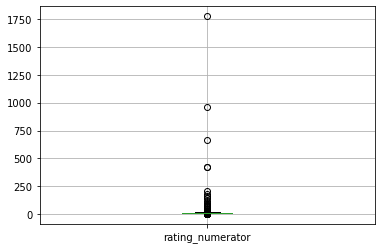

In [29]:
#check for extreme values in the rating_numerator
tweet_arch[['rating_numerator']].boxplot()

<AxesSubplot:>

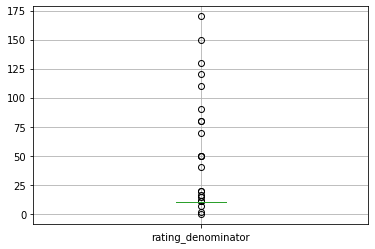

In [30]:
tweet_arch[['rating_denominator']].boxplot()

In [31]:
# ssee the extreme values in the rating_numerator column
tweet_arch[tweet_arch['rating_numerator'] > 15]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
55,881633300179243008,8.816070e+17,4.738443e+07,2017-07-02 21:58:53 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@roushfenway These are good dogs but 17/10 is an emotional impulse rating. More like 13/10s,NaN,NaN,NaN,NaN,17,10,None,None,None,None,None
188,855862651834028034,8.558616e+17,1.943518e+08,2017-04-22 19:15:32 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@dhmontgomery We also gave snoop dogg a 420/10 but I think that predated your research,NaN,NaN,NaN,NaN,420,10,None,None,None,None,None
189,855860136149123072,8.558585e+17,1.361572e+07,2017-04-22 19:05:32 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","@s8n You tried very hard to portray this good boy as not so good, but you have ultimately failed. His goodness shines through. 666/10",NaN,NaN,NaN,NaN,666,10,None,None,None,None,None
290,838150277551247360,8.381455e+17,2.195506e+07,2017-03-04 22:12:52 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@markhoppus 182/10,NaN,NaN,NaN,NaN,182,10,None,None,None,None,None
313,835246439529840640,8.352460e+17,2.625958e+07,2017-02-24 21:54:03 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","@jonnysun @Lin_Manuel ok jomny I know you're excited but 960/00 isn't a valid rating, 13/10 is tho",NaN,NaN,NaN,NaN,960,0,None,None,None,None,None
340,832215909146226688,NaN,NaN,2017-02-16 13:11:49 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","RT @dog_rates: This is Logan, the Chow who lived. He solemnly swears he's up to lots of good. H*ckin magical af 9.75/10 https://t.co/yBO5wu…",7.867091e+17,4.196984e+09,2016-10-13 23:23:56 +0000,https://twitter.com/dog_rates/status/786709082849828864/photo/1,75,10,Logan,None,None,None,None
433,820690176645140481,NaN,NaN,2017-01-15 17:52:40 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",The floofs have been released I repeat the floofs have been released. 84/70 https://t.co/NIYC820tmd,NaN,NaN,NaN,"https://twitter.com/dog_rates/status/820690176645140481/photo/1,https://twitter.com/dog_rates/status/820690176645140481/photo/1,https://twitter.com/dog_rates/status/820690176645140481/photo/1",84,70,None,None,None,None,None
516,810984652412424192,NaN,NaN,2016-12-19 23:06:23 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Meet Sam. She smiles 24/7 &amp; secretly aspires to be a reindeer. \nKeep Sam smiling by clicking and sharing this link:\nhttps://t.co/98tB8y7y7t https://t.co/LouL5vdvxx,NaN,NaN,NaN,"https://www.gofundme.com/sams-smile,https://twitter.com/dog_rates/status/810984652412424192/photo/1",24,7,Sam,None,None,None,None
695,786709082849828864,NaN,NaN,2016-10-13 23:23:56 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Logan, the Chow who lived. He solemnly swears he's up to lots of good. H*ckin magical af 9.75/10 https://t.co/yBO5wuqaPS",NaN,NaN,NaN,https://twitter.com/dog_rates/status/786709082849828864/photo/1,75,10,Logan,None,None,None,None
763,778027034220126208,NaN,NaN,2016-09-20 00:24:34 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Sophie. She's a Jubilant Bush Pupper. Super h*ckin rare. Appears at random just to smile at the locals. 11.27/10 would smile back https://t.co/QFaUiIHxHq,NaN,NaN,NaN,https://twitter.com/dog_rates/status/778027034220126208/photo/1,27,10,Sophie,None,None,pupper,None


In [32]:
# ssee the extreme values in the rating_denominator column
tweet_arch[tweet_arch['rating_denominator'] > 10]

,tweet_id,in_reply_to_status_id,in_reply_to_user_id,timestamp,source,text,retweeted_status_id,retweeted_status_user_id,retweeted_status_timestamp,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
342,832088576586297345,8.320875e+17,3.058208e+07,2017-02-16 04:45:50 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@docmisterio account started on 11/15/15,NaN,NaN,NaN,NaN,11,15,None,None,None,None,None
433,820690176645140481,NaN,NaN,2017-01-15 17:52:40 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",The floofs have been released I repeat the floofs have been released. 84/70 https://t.co/NIYC820tmd,NaN,NaN,NaN,"https://twitter.com/dog_rates/status/820690176645140481/photo/1,https://twitter.com/dog_rates/status/820690176645140481/photo/1,https://twitter.com/dog_rates/status/820690176645140481/photo/1",84,70,None,None,None,None,None
784,775096608509886464,NaN,NaN,2016-09-11 22:20:06 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","RT @dog_rates: After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP https:/…",7.403732e+17,4.196984e+09,2016-06-08 02:41:38 +0000,"https://twitter.com/dog_rates/status/740373189193256964/photo/1,https://twitter.com/dog_rates/status/740373189193256964/photo/1,https://twitter.com/dog_rates/status/740373189193256964/photo/1,https://twitter.com/dog_rates/status/740373189193256964/photo/1",9,11,None,None,None,None,None
902,758467244762497024,NaN,NaN,2016-07-28 01:00:57 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Why does this never happen at my front door... 165/150 https://t.co/HmwrdfEfUE,NaN,NaN,NaN,https://twitter.com/dog_rates/status/758467244762497024/video/1,165,150,None,None,None,None,None
1068,740373189193256964,NaN,NaN,2016-06-08 02:41:38 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP https://t.co/XAVDNDaVgQ",NaN,NaN,NaN,"https://twitter.com/dog_rates/status/740373189193256964/photo/1,https://twitter.com/dog_rates/status/740373189193256964/photo/1,https://twitter.com/dog_rates/status/740373189193256964/photo/1,https://twitter.com/dog_rates/status/740373189193256964/photo/1",9,11,None,None,None,None,None
1120,731156023742988288,NaN,NaN,2016-05-13 16:15:54 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Say hello to this unbelievably well behaved squad of doggos. 204/170 would try to pet all at once https://t.co/yGQI3He3xv,NaN,NaN,NaN,https://twitter.com/dog_rates/status/731156023742988288/photo/1,204,170,this,None,None,None,None
1165,722974582966214656,NaN,NaN,2016-04-21 02:25:47 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Happy 4/20 from the squad! 13/10 for all https://t.co/eV1diwds8a,NaN,NaN,NaN,https://twitter.com/dog_rates/status/722974582966214656/photo/1,4,20,None,None,None,None,None
1202,716439118184652801,NaN,NaN,2016-04-03 01:36:11 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Bluebert. He just saw that both #FinalFur match ups are split 50/50. Amazed af. 11/10 https://t.co/Kky1DPG4iq,NaN,NaN,NaN,https://twitter.com/dog_rates/status/716439118184652801/photo/1,50,50,Bluebert,None,None,None,None
1228,713900603437621249,NaN,NaN,2016-03-27 01:29:02 +0000,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Happy Saturday here's 9 puppers on a bench. 99/90 good work everybody https://t.co/mpvaVxKmc1,NaN,NaN,NaN,https://twitter.com/dog_rates/status/713900603437621249/photo/1,99,90,None,None,None,None,None
1254,710658690886586372,NaN,NaN,2016-03-18 02:46:49 +0000,"<a hr

#### Observation

some of the denominator and numerator of ratings were wrongly collected and the correct value can be seen from the text

#### Image Prediction table

In [33]:
# view a sample of the table
img_pred.sample(10)

,tweet_id,jpg_url,img_num,p1,p1_conf,p1_dog,p2,p2_conf,p2_dog,p3,p3_conf,p3_dog
460,674793399141146624,https://pbs.twimg.com/media/CV1ZA3oWEAA1HW_.jpg,1,giant_schnauzer,0.119693,True,Afghan_hound,0.072763,True,miniature_schnauzer,0.063786,True
164,668975677807423489,https://pbs.twimg.com/media/CUit1O1WoAEBHjj.jpg,1,basset,0.605437,True,Welsh_springer_spaniel,0.184783,True,Saint_Bernard,0.116299,True
1646,808501579447930884,https://pbs.twimg.com/media/Czhf4XtVQAAIqpd.jpg,2,Airedale,0.454239,True,cocker_spaniel,0.219323,True,Irish_terrier,0.093193,True
911,700796979434098688,https://pbs.twimg.com/media/Cbm7IeUXIAA6Lc-.jpg,1,tailed_frog,0.652712,False,tree_frog,0.280212,False,bullfrog,0.040177,False
633,680970795137544192,https://pbs.twimg.com/media/CXNLU6wWkAE0OkJ.jpg,1,pug,0.713102,True,whippet,0.057426,True,quilt,0.056018,False
520,676533798876651520,https://pbs.twimg.com/media/CWOH4s9U8AEtkmQ.jpg,1,chow,0.265274,True,ice_bear,0.167614,False,fur_coat,0.117506,False
571,678399652199309312,https://pbs.twimg.com/ext_tw_video_thumb/678399528077250560/pu/img/BOjUNHRsYLeSo0hl.jpg,1,swing,0.929196,False,Bedlington_terrier,0.015047,True,Great_Pyrenees,0.014039,True
2025,881906580714921986,https://pbs.twimg.com/media/DD0pWm9XcAAeSBL.jpg,1,Weimaraner,0.291539,True,Chesapeake_Bay_retriever,0.278966,True,koala,0.127017,False
238,670434127938719744,https://pbs.twimg.com/media/CU3cSG8W4AIAePH.jpg,1,jack-o'-lantern,0.919140,False,Chesapeake_Bay_retriever,0.027351,True,Labrador_retriever,0.020081,True
1251,747933425676525569,https://pbs.twimg.com/media/CmExV2qWkAAn_pN.jpg,1,Samoyed,0.998201,True,Eskimo_dog,0.000793,True,Great_Pyrenees,0.000296,True


In [34]:
# See information summary of the columns in the table
img_pred.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2075 entries, 0 to 2074
Data columns (total 12 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   tweet_id  2075 non-null   int64  
 1   jpg_url   2075 non-null   object 
 2   img_num   2075 non-null   int64  
 3   p1        2075 non-null   object 
 4   p1_conf   2075 non-null   float64
 5   p1_dog    2075 non-null   bool   
 6   p2        2075 non-null   object 
 7   p2_conf   2075 non-null   float64
 8   p2_dog    2075 non-null   bool   
 9   p3        2075 non-null   object 
 10  p3_conf   2075 non-null   float64
 11  p3_dog    2075 non-null   bool   
dtypes: bool(3), float64(3), int64(2), object(4)
memory usage: 152.1+ KB


In [35]:
# check for duplicated values in the tweet id
img_pred['tweet_id'].duplicated().sum()

0

##### downloaded twitter data|


In [36]:
# Information summary of the data
tweet_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2327 entries, 0 to 2326
Data columns (total 3 columns):
 #   Column          Non-Null Count  Dtype
---  ------          --------------  -----
 0   tweet_id        2327 non-null   int64
 1   retweet_count   2327 non-null   int64
 2   favorite_count  2327 non-null   int64
dtypes: int64(3)
memory usage: 54.7 KB


In [37]:
# see a sample of the data
tweet_df.sample(10)

,tweet_id,retweet_count,favorite_count
184,855459453768019968,7315,27127
604,795464331001561088,22009,46851
1427,695409464418041856,3262,8016
910,753294487569522689,961,3126
2280,666804364988780544,79,205
1661,681340665377193984,245,1520
1954,672964561327235073,557,1261
1247,709179584944730112,611,1859
497,810984652412424192,1335,5057
1516,689517482558820352,1301,3140


In [38]:
# summary statistics of the data
tweet_df.describe()

,tweet_id,retweet_count,favorite_count
count,2.327000e+03,2327.000000,2327.000000
mean,7.417930e+17,2473.055436,7055.610228
std,6.820795e+16,4188.314671,10962.711659
min,6.660209e+17,1.000000,0.000000
25%,6.781394e+17,495.000000,1225.000000
50%,7.178418e+17,1149.000000,3052.000000
75%,7.986547e+17,2864.500000,8606.500000
max,8.924206e+17,70811.000000,144912.000000


In [39]:
#check for duplicates
tweet_df[tweet_df['tweet_id'].duplicated()]

,tweet_id,retweet_count,favorite_count


In [40]:
# Check for duplicated columns in all datasets
all_columns = pd.Series(list(tweet_df) + list(img_pred) + list(tweet_arch))
all_columns[all_columns.duplicated()]

3     tweet_id
15    tweet_id
dtype: object

### Quality issues

-  tweet archive table

1. Some retweets and replies were included in the datasets, these constitutes most percentages of the null values  

2. Erroneous datatypes

3. Innacurate values in the ratings_denominator and ratings_numerator columns


4. Some names of dogs in the tweet archive table are not given, instead they are replaced with the words 'None' and 'a'

5. Duplicates and NA values in the expanded urls column.

6. In the expanded url column in tweet archive, the urls are repeated on one row making them irregular


7. The source column is unfiltered, making the data not understandable

8. Some values were gotten from vine and not twitter as seen in the source column


- Image prediction table

9. non descriptive names in the img_pred columns

### Tidiness issues

10. The stages of dog format should be in one column

11. Irregularities in the casing of the predicted names of dogs in the image prediction table, some and in lower case and others in title case

12. the ratings should be in a column

13. all dataframes should be in one table

## Cleaning Data
In this section, clean **all** of the issues you documented while assessing. 

**Note:** Make a copy of the original data before cleaning. Cleaning includes merging individual pieces of data according to the rules of [tidy data](https://cran.r-project.org/web/packages/tidyr/vignettes/tidy-data.html). The result should be a high-quality and tidy master pandas DataFrame (or DataFrames, if appropriate).

In [41]:
# Make copies of original pieces of data
img_pred_clean = img_pred.copy()
tweet_arch_clean = tweet_arch.copy()
tweet_df_clean = tweet_df.copy()

### Issue #1: Some retweets and replies were included in the datasets, these constitutes most percentages of the null values

#### Define: Drop rows with retweets, replies and other missing values as we would only work with original tweets

In [42]:
# Retweets usually have text beginning with 'RT @', identify rows like this and drop them
retweets_index = tweet_arch_clean[tweet_arch_clean['text'].str.contains('RT @')].index
tweet_arch_clean.drop(retweets_index, inplace=True)

In [43]:
# drop columns with lots of null values
tweet_arch_clean.drop(['in_reply_to_status_id','in_reply_to_user_id','retweeted_status_id','retweeted_status_user_id','retweeted_status_timestamp'], inplace=True, axis=1)

#### Test

In [44]:
tweet_arch_clean[tweet_arch_clean['text'].str.contains('RT @')]

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo


In [45]:
# see summary information of the columns in twitter archive table
tweet_arch_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2175 entries, 0 to 2355
Data columns (total 12 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   tweet_id            2175 non-null   int64 
 1   timestamp           2175 non-null   object
 2   source              2175 non-null   object
 3   text                2175 non-null   object
 4   expanded_urls       2117 non-null   object
 5   rating_numerator    2175 non-null   int64 
 6   rating_denominator  2175 non-null   int64 
 7   name                2175 non-null   object
 8   doggo               2175 non-null   object
 9   floofer             2175 non-null   object
 10  pupper              2175 non-null   object
 11  puppo               2175 non-null   object
dtypes: int64(3), object(9)
memory usage: 220.9+ KB


### Issue #2: Erroneous Datatype

#### Define

The timestamp datatype should be converted to the pandas datetime

#### Code

In [46]:
# Change the timestamp from object to pandas datatime
tweet_arch_clean['timestamp'] = pd.to_datetime(tweet_arch['timestamp'])

#### Test

In [47]:
# check the datatype for the timestamp column in the tweet archive dataset
tweet_arch_clean['timestamp'].dtype

datetime64[ns, UTC]

### Issue #3: Innacurate values in the ratings_denominator and ratings_numerator columns

#### Define: denominator and numerator values that looks like outliers shoulc be identified and dropped, correct the innacurately inputted values

#### Code

In [48]:
# Use value counts to see irregular values in the denominator columns
tweet_arch_clean['rating_denominator'].value_counts()

10     2153
50     3   
11     2   
20     2   
80     2   
15     1   
70     1   
7      1   
150    1   
170    1   
0      1   
90     1   
40     1   
130    1   
110    1   
16     1   
120    1   
2      1   
Name: rating_denominator, dtype: int64

In [49]:
#check the text column to identify values to be corrected
tweet_arch_clean[tweet_arch_clean['rating_denominator'] != 10]

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
313,835246439529840640,2017-02-24 21:54:03+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","@jonnysun @Lin_Manuel ok jomny I know you're excited but 960/00 isn't a valid rating, 13/10 is tho",NaN,960,0,None,None,None,None,None
342,832088576586297345,2017-02-16 04:45:50+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@docmisterio account started on 11/15/15,NaN,11,15,None,None,None,None,None
433,820690176645140481,2017-01-15 17:52:40+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",The floofs have been released I repeat the floofs have been released. 84/70 https://t.co/NIYC820tmd,"https://twitter.com/dog_rates/status/820690176645140481/photo/1,https://twitter.com/dog_rates/status/820690176645140481/photo/1,https://twitter.com/dog_rates/status/820690176645140481/photo/1",84,70,None,None,None,None,None
516,810984652412424192,2016-12-19 23:06:23+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Meet Sam. She smiles 24/7 &amp; secretly aspires to be a reindeer. \nKeep Sam smiling by clicking and sharing this link:\nhttps://t.co/98tB8y7y7t https://t.co/LouL5vdvxx,"https://www.gofundme.com/sams-smile,https://twitter.com/dog_rates/status/810984652412424192/photo/1",24,7,Sam,None,None,None,None
902,758467244762497024,2016-07-28 01:00:57+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Why does this never happen at my front door... 165/150 https://t.co/HmwrdfEfUE,https://twitter.com/dog_rates/status/758467244762497024/video/1,165,150,None,None,None,None,None
1068,740373189193256964,2016-06-08 02:41:38+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","After so many requests, this is Bretagne. She was the last surviving 9/11 search dog, and our second ever 14/10. RIP https://t.co/XAVDNDaVgQ","https://twitter.com/dog_rates/status/740373189193256964/photo/1,https://twitter.com/dog_rates/status/740373189193256964/photo/1,https://twitter.com/dog_rates/status/740373189193256964/photo/1,https://twitter.com/dog_rates/status/740373189193256964/photo/1",9,11,None,None,None,None,None
1120,731156023742988288,2016-05-13 16:15:54+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Say hello to this unbelievably well behaved squad of doggos. 204/170 would try to pet all at once https://t.co/yGQI3He3xv,https://twitter.com/dog_rates/status/731156023742988288/photo/1,204,170,this,None,None,None,None
1165,722974582966214656,2016-04-21 02:25:47+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Happy 4/20 from the squad! 13/10 for all https://t.co/eV1diwds8a,https://twitter.com/dog_rates/status/722974582966214656/photo/1,4,20,None,None,None,None,None
1202,716439118184652801,2016-04-03 01:36:11+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Bluebert. He just saw that both #FinalFur match ups are split 50/50. Amazed af. 11/10 https://t.co/Kky1DPG4iq,https://twitter.com/dog_rates/status/716439118184652801/photo/1,50,50,Bluebert,None,None,None,None
1228,713900603437621249,2016-03-27 01:29:02+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Happy Saturday here's 9 puppers on a bench. 99/90 good work everybody https://t.co/mpvaVxKmc1,https://twitter.com/dog_rates/status/713900603437621249/photo/1,99,90,None,None,None,None,None


In [50]:
#check the text column to identify values to be corrected
tweet_arch_clean[tweet_arch_clean['rating_numerator'] > 15]

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
55,881633300179243008,2017-07-02 21:58:53+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@roushfenway These are good dogs but 17/10 is an emotional impulse rating. More like 13/10s,NaN,17,10,None,None,None,None,None
188,855862651834028034,2017-04-22 19:15:32+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@dhmontgomery We also gave snoop dogg a 420/10 but I think that predated your research,NaN,420,10,None,None,None,None,None
189,855860136149123072,2017-04-22 19:05:32+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","@s8n You tried very hard to portray this good boy as not so good, but you have ultimately failed. His goodness shines through. 666/10",NaN,666,10,None,None,None,None,None
290,838150277551247360,2017-03-04 22:12:52+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@markhoppus 182/10,NaN,182,10,None,None,None,None,None
313,835246439529840640,2017-02-24 21:54:03+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","@jonnysun @Lin_Manuel ok jomny I know you're excited but 960/00 isn't a valid rating, 13/10 is tho",NaN,960,0,None,None,None,None,None
433,820690176645140481,2017-01-15 17:52:40+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",The floofs have been released I repeat the floofs have been released. 84/70 https://t.co/NIYC820tmd,"https://twitter.com/dog_rates/status/820690176645140481/photo/1,https://twitter.com/dog_rates/status/820690176645140481/photo/1,https://twitter.com/dog_rates/status/820690176645140481/photo/1",84,70,None,None,None,None,None
516,810984652412424192,2016-12-19 23:06:23+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Meet Sam. She smiles 24/7 &amp; secretly aspires to be a reindeer. \nKeep Sam smiling by clicking and sharing this link:\nhttps://t.co/98tB8y7y7t https://t.co/LouL5vdvxx,"https://www.gofundme.com/sams-smile,https://twitter.com/dog_rates/status/810984652412424192/photo/1",24,7,Sam,None,None,None,None
695,786709082849828864,2016-10-13 23:23:56+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>","This is Logan, the Chow who lived. He solemnly swears he's up to lots of good. H*ckin magical af 9.75/10 https://t.co/yBO5wuqaPS",https://twitter.com/dog_rates/status/786709082849828864/photo/1,75,10,Logan,None,None,None,None
763,778027034220126208,2016-09-20 00:24:34+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",This is Sophie. She's a Jubilant Bush Pupper. Super h*ckin rare. Appears at random just to smile at the locals. 11.27/10 would smile back https://t.co/QFaUiIHxHq,https://twitter.com/dog_rates/status/778027034220126208/photo/1,27,10,Sophie,None,None,pupper,None
902,758467244762497024,2016-07-28 01:00:57+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",Why does this never happen at my front door... 165/150 https://t.co/HmwrdfEfUE,https://twitter.com/dog_rates/status/758467244762497024/video/1,165,150,None,None,None,None,None


###### values to be corrected
- 313  13/10
- 1068 14/10
- 1165 13/10
- 1202 11/10
- 1663 10/10
- 2335 9/10
- 1662 10/10
- 55   13/10

In [51]:
# Assign the right values to the rating denominator
tweet_arch_clean.at[[313,1068,1165,1202,1663,2335,1662], 'rating_denominator'] = 10
# Assign the right cvalues to the rating numerator
tweet_arch_clean.at[313, 'rating_numerator'] = 13
tweet_arch_clean.at[1068, 'rating_numerator'] = 14
tweet_arch_clean.at[1165, 'rating_numerator'] = 13
tweet_arch_clean.at[1202, 'rating_numerator'] = 11
tweet_arch_clean.at[1663, 'rating_numerator'] = 10
tweet_arch_clean.at[2335, 'rating_numerator'] = 9
tweet_arch_clean.at[1662, 'rating_numerator'] = 10
tweet_arch_clean.at[55, 'rating_numerator'] = 13

In [52]:
# we drop rows with values that are not equal to 10
irregular_rating = tweet_arch_clean[tweet_arch_clean['rating_denominator'] != 10].index
tweet_arch_clean.drop(irregular_rating, inplace=True)

In [53]:
# Use value counts to see irregular values in the numerator columns
tweet_arch_clean['rating_numerator'].value_counts(ascending=True)

1776    1  
27      1  
75      1  
26      1  
666     1  
15      1  
182     1  
0       2  
420     2  
1       7  
2       9  
4       15 
3       19 
6       32 
5       36 
14      44 
7       53 
8       98 
9       156
13      310
11      426
10      444
12      500
Name: rating_numerator, dtype: int64

In [54]:
# We drop numerator ratings above 15
irregular_rating = tweet_arch_clean[tweet_arch_clean['rating_numerator'] > 15].index
tweet_arch_clean.drop(irregular_rating, inplace=True)

#### Test

In [55]:
tweet_arch_clean.loc[1068]['rating_denominator']

10

In [56]:
tweet_arch_clean['rating_denominator'].value_counts()

10    2152
Name: rating_denominator, dtype: int64

In [57]:
tweet_arch_clean['rating_numerator'].value_counts().sort_index()

0     2  
1     7  
2     9  
3     19 
4     15 
5     36 
6     32 
7     53 
8     98 
9     156
10    444
11    426
12    500
13    310
14    44 
15    1  
Name: rating_numerator, dtype: int64

### Issue #4: Some names of dogs in the tweet archive table are not given, instead they are replaced with the words 'None' and 'a'

#### Define: Identify dogs that were mis-named and replace them with a variable to indicate their name is not known

#### Code

In [58]:
# Use value counts to check for the unique names of dogs
tweet_arch_clean['name'].value_counts()

None              663
a                 54 
Lucy              11 
Charlie           11 
Cooper            10 
Oliver            10 
Tucker            9  
Penny             9  
the               8  
Lola              8  
Sadie             8  
Winston           8  
Daisy             7  
Toby              7  
Oscar             6  
Stanley           6  
Jax               6  
Bella             6  
Bo                6  
Bailey            6  
Koda              6  
an                6  
Milo              5  
Leo               5  
Buddy             5  
Rusty             5  
Dave              5  
Chester           5  
Bentley           5  
Scout             5  
Louis             5  
Sammy             4  
Duke              4  
Boomer            4  
Finn              4  
Brody             4  
Maggie            4  
George            4  
Winnie            4  
Phil              4  
Jerry             4  
Jack              4  
Clark             4  
Larry             4  
Clarence          4  
Alfie     

In [59]:
# Replace names 'None' and 'a' with 'unknown'
tweet_arch_clean['name'].replace(to_replace=['None', 'a'], value='Unknown', inplace=True)

#### Test

In [60]:
tweet_arch_clean['name'].value_counts()

Unknown           717
Lucy              11 
Charlie           11 
Cooper            10 
Oliver            10 
Penny             9  
Tucker            9  
Sadie             8  
Winston           8  
the               8  
Lola              8  
Daisy             7  
Toby              7  
Oscar             6  
Bella             6  
Stanley           6  
Koda              6  
Bo                6  
an                6  
Jax               6  
Bailey            6  
Rusty             5  
Milo              5  
Chester           5  
Bentley           5  
Louis             5  
Buddy             5  
Leo               5  
Scout             5  
Dave              5  
Winnie            4  
George            4  
Clarence          4  
Maggie            4  
Jerry             4  
Oakley            4  
Jack              4  
Chip              4  
very              4  
Boomer            4  
Brody             4  
Larry             4  
Sammy             4  
Gary              4  
Phil              4  
Alfie     

### Issue #5:  Duplicates and NA values in the expanded urls column.

#### Define: drop duplicates and nan values in the expanded urls

#### Code

In [61]:
# Drop rows with duplicated expanded urls values
tweet_arch_clean = tweet_arch_clean.drop_duplicates(['expanded_urls'])

In [62]:
# Check for where there is na values
tweet_arch_clean[tweet_arch_clean['expanded_urls'].isna()]

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
30,886267009285017600,2017-07-15 16:51:35+00:00,"<a href=""http://twitter.com/download/iphone"" rel=""nofollow"">Twitter for iPhone</a>",@NonWhiteHat @MayhewMayhem omg hello tanner you are a scary good boy 12/10 would pet with extreme caution,NaN,12,10,Unknown,None,None,None,None


In [63]:
# Drop nan values from the expanded url column
tweet_arch_clean.drop(30, inplace=True)

#### Test

In [64]:
tweet_arch_clean[tweet_arch_clean['expanded_urls'].duplicated()]

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo


In [65]:
tweet_arch_clean[tweet_arch_clean['expanded_urls'].isna()]

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo


### Issue #6: In the expanded url column in tweet archive, the urls are repeated on one row making them irregular

#### Define: Identify values in the expanded url column that are repeated and remove them

#### Code


In [66]:
tweet_arch_clean['expanded_urls'] = tweet_arch_clean['expanded_urls'].apply(lambda x: x.split(',')[-1])

In [67]:
tweet_arch_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2098 entries, 0 to 2355
Data columns (total 12 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   tweet_id            2098 non-null   int64              
 1   timestamp           2098 non-null   datetime64[ns, UTC]
 2   source              2098 non-null   object             
 3   text                2098 non-null   object             
 4   expanded_urls       2098 non-null   object             
 5   rating_numerator    2098 non-null   int64              
 6   rating_denominator  2098 non-null   int64              
 7   name                2098 non-null   object             
 8   doggo               2098 non-null   object             
 9   floofer             2098 non-null   object             
 10  pupper              2098 non-null   object             
 11  puppo               2098 non-null   object             
dtypes: datetime64[ns, UTC](1), int64(3

#### Test

In [68]:
tweet_arch_clean[tweet_arch_clean['expanded_urls'].str.contains(',')]

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo


### Issue #7: The source column is unfiltered, making the data not understandable

#### Define: extract the relevant source of the tweet from the html tag using split function

#### Code

In [69]:
# split the html tag to get the source
tweet_arch_clean['source'] = tweet_arch_clean['source'].apply(lambda x: x.split('</a>')[0].split('>')[-1])
# Make the datatype in this column the category datatype
tweet_arch_clean['source'] = tweet_arch_clean['source'].astype('category')

#### Test

In [70]:
tweet_arch_clean['source'].value_counts()

Twitter for iPhone     1968
Vine - Make a Scene    90  
Twitter Web Client     30  
TweetDeck              10  
Name: source, dtype: int64

### Issue #8: Some values were gotten from vine and not twitter as seen in the source column

#### Define: Drop rows with values from VIne

#### code

In [71]:
tweet_arch_clean.head()

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo
0,892420643555336193,2017-08-01 16:23:56+00:00,Twitter for iPhone,This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU,https://twitter.com/dog_rates/status/892420643555336193/photo/1,13,10,Phineas,None,None,None,None
1,892177421306343426,2017-08-01 00:17:27+00:00,Twitter for iPhone,"This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10 https://t.co/0Xxu71qeIV",https://twitter.com/dog_rates/status/892177421306343426/photo/1,13,10,Tilly,None,None,None,None
2,891815181378084864,2017-07-31 00:18:03+00:00,Twitter for iPhone,This is Archie. He is a rare Norwegian Pouncing Corgo. Lives in the tall grass. You never know when one may strike. 12/10 https://t.co/wUnZnhtVJB,https://twitter.com/dog_rates/status/891815181378084864/photo/1,12,10,Archie,None,None,None,None
3,891689557279858688,2017-07-30 15:58:51+00:00,Twitter for iPhone,This is Darla. She commenced a snooze mid meal. 13/10 happens to the best of us https://t.co/tD36da7qLQ,https://twitter.com/dog_rates/status/891689557279858688/photo/1,13,10,Darla,None,None,None,None
4,891327558926688256,2017-07-29 16:00:24+00:00,Twitter for iPhone,"This is Franklin. He would like you to stop calling him ""cute."" He is a very fierce shark and should be respected as such. 12/10 #BarkWeek https://t.co/AtUZn91f7f",https://twitter.com/dog_rates/status/891327558926688256/photo/1,12,10,Franklin,None,None,None,None


In [72]:
tweet_arch_clean = tweet_arch_clean[tweet_arch_clean['source'] != 'Vine - Make a Scene']

#### Test

In [73]:
tweet_arch_clean[tweet_arch_clean['source'] == 'Vine - Make a Scene']

,tweet_id,timestamp,source,text,expanded_urls,rating_numerator,rating_denominator,name,doggo,floofer,pupper,puppo


### Issue #9: non descriptive names in the img_pred columns

#### Define: Rename columns in the image prediction table with names that easily describes their content

#### Code

In [74]:
# rename thw columns (p1,p2,p3,p1conf,p2conf,p3conf)
img_pred_clean = img_pred_clean.rename(columns={"p1": "prediction_1", "p2": "prediction_2",
                                           'p3': "prediction_3", "p1_conf": "p1_confidence",
                                           "p2_conf": "p2_confidence", "p3_conf": "p3_confidence"})

#### Test

In [75]:
img_pred_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2075 entries, 0 to 2074
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   tweet_id       2075 non-null   int64  
 1   jpg_url        2075 non-null   object 
 2   img_num        2075 non-null   int64  
 3   prediction_1   2075 non-null   object 
 4   p1_confidence  2075 non-null   float64
 5   p1_dog         2075 non-null   bool   
 6   prediction_2   2075 non-null   object 
 7   p2_confidence  2075 non-null   float64
 8   p2_dog         2075 non-null   bool   
 9   prediction_3   2075 non-null   object 
 10  p3_confidence  2075 non-null   float64
 11  p3_dog         2075 non-null   bool   
dtypes: bool(3), float64(3), int64(2), object(4)
memory usage: 152.1+ KB


### Issue #10(Tidiness): The stages of dog format should be in one column

#### Define: #### Define: Replace the values none in the doggo, floofer, pupper and puppo columns with np.nan, then collapse them into a column

#### Code

In [76]:
# collapse the doggo, floofer, pupper and puppo into one column
tweet_arch_clean['dog_stages'] = tweet_arch_clean[['doggo', 'floofer','pupper','puppo']].replace('None', np.nan).bfill(axis=1).iloc[:, 0]

In [77]:
# drop the columns that were collapsed
tweet_arch_clean = tweet_arch_clean.drop(columns = ['doggo', 'floofer','pupper','puppo'], axis=1)

#### Test

In [78]:
tweet_arch_clean.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2008 entries, 0 to 2355
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype              
---  ------              --------------  -----              
 0   tweet_id            2008 non-null   int64              
 1   timestamp           2008 non-null   datetime64[ns, UTC]
 2   source              2008 non-null   category           
 3   text                2008 non-null   object             
 4   expanded_urls       2008 non-null   object             
 5   rating_numerator    2008 non-null   int64              
 6   rating_denominator  2008 non-null   int64              
 7   name                2008 non-null   object             
 8   dog_stages          311 non-null    object             
dtypes: category(1), datetime64[ns, UTC](1), int64(3), object(4)
memory usage: 143.3+ KB


### Issue #11: Irregularities in the casing of the predicted names of dogs in the image prediction table, some and in lower case and others in title case

#### Define: make all predicted names of dogs lower case and remove the underscore between each word in the names

#### Code

In [79]:
img_pred_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2075 entries, 0 to 2074
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   tweet_id       2075 non-null   int64  
 1   jpg_url        2075 non-null   object 
 2   img_num        2075 non-null   int64  
 3   prediction_1   2075 non-null   object 
 4   p1_confidence  2075 non-null   float64
 5   p1_dog         2075 non-null   bool   
 6   prediction_2   2075 non-null   object 
 7   p2_confidence  2075 non-null   float64
 8   p2_dog         2075 non-null   bool   
 9   prediction_3   2075 non-null   object 
 10  p3_confidence  2075 non-null   float64
 11  p3_dog         2075 non-null   bool   
dtypes: bool(3), float64(3), int64(2), object(4)
memory usage: 152.1+ KB


In [80]:
# remove the underscore between the names of the dogs and give all names a uniform casing
img_pred_clean[['prediction_1','prediction_2','prediction_3']] = img_pred_clean[['prediction_1','prediction_2','prediction_3']].apply(lambda x: x.str.replace('_',' '))
img_pred_clean[['prediction_1','prediction_2','prediction_3']] = img_pred_clean[['prediction_1','prediction_2','prediction_3']].apply(lambda x: x.str.title())

#### Test

In [81]:
# check a dample of the dataframe
img_pred_clean.sample(10)

,tweet_id,jpg_url,img_num,prediction_1,p1_confidence,p1_dog,prediction_2,p2_confidence,p2_dog,prediction_3,p3_confidence,p3_dog
559,677700003327029250,https://pbs.twimg.com/media/CWesj06W4AAIKl8.jpg,1,Siberian Husky,0.120849,True,Junco,0.079206,False,Malamute,0.063088,True
38,666644823164719104,https://pbs.twimg.com/media/CUBl6IwVAAA9_zT.jpg,1,Ibizan Hound,0.044333,True,Pembroke,0.043209,True,West Highland White Terrier,0.038906,True
1644,808106460588765185,https://pbs.twimg.com/media/Czb4iFRXgAIUMiN.jpg,1,Golden Retriever,0.426183,True,Labrador Retriever,0.257447,True,Great Pyrenees,0.126482,True
1110,724004602748780546,https://pbs.twimg.com/media/CgwuWCeW4AAsgbD.jpg,3,Siamese Cat,0.950526,False,Pug,0.018877,True,Quilt,0.007628,False
955,705239209544720384,https://pbs.twimg.com/media/CcmDUjFW8AAqAjc.jpg,1,Chihuahua,0.157950,True,Toy Terrier,0.089920,True,Mexican Hairless,0.063225,True
242,670449342516494336,https://pbs.twimg.com/media/CU3qHNTWsAApGr0.jpg,1,Peacock,0.999924,False,European Gallinule,0.000030,False,Agama,0.000022,False
540,676975532580409345,https://pbs.twimg.com/media/CWUZpydWcAAeipD.jpg,1,Malamute,0.363257,True,Siberian Husky,0.245862,True,Eskimo Dog,0.125547,True
1705,817423860136083457,https://pbs.twimg.com/ext_tw_video_thumb/817423809049493505/pu/img/5OFW0yueFu9oTUiQ.jpg,1,Ice Bear,0.336200,False,Samoyed,0.201358,True,Eskimo Dog,0.186789,True
35,666437273139982337,https://pbs.twimg.com/media/CT-pKmRWIAAxUWj.jpg,1,Chihuahua,0.671853,True,Beagle,0.124680,True,Saluki,0.044094,True
2036,884441805382717440,https://pbs.twimg.com/media/DEYrIZwWsAA2Wo5.jpg,1,Pembroke,0.993225,True,Cardigan,0.003216,True,Chihuahua,0.002081,True


### Issue #12: The ratings would be better in one table

#### Define: Create a ratings column to house both the numerator and denominator

#### Code

In [82]:
tweet_arch_clean['ratings'] = (tweet_arch_clean['rating_numerator'] / tweet_arch_clean['rating_denominator'])

In [83]:
tweet_arch_clean.drop(['rating_numerator', 'rating_denominator'], axis=1, inplace=True)

#### Test

#### Test

In [84]:
tweet_arch_clean['ratings'].head()

0    1.3
1    1.3
2    1.2
3    1.3
4    1.2
Name: ratings, dtype: float64

### Issue #13: all dataframes should be in one table

#### Define: merge the tweet df to the tweet archive dataframe, then merge the result with the image predict dataframe

#### Code

In [85]:
# merge tweet archive with the tweet df
tweet_clean =pd.merge(tweet_arch_clean, tweet_df_clean, on='tweet_id', how='inner')

In [86]:
# merge the tweet clean with image prediction dataframe
twitter_master = pd.merge(tweet_clean, img_pred_clean, on='tweet_id', how='inner')

#### Test

In [87]:
twitter_master.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1968 entries, 0 to 1967
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype              
---  ------          --------------  -----              
 0   tweet_id        1968 non-null   int64              
 1   timestamp       1968 non-null   datetime64[ns, UTC]
 2   source          1968 non-null   category           
 3   text            1968 non-null   object             
 4   expanded_urls   1968 non-null   object             
 5   name            1968 non-null   object             
 6   dog_stages      304 non-null    object             
 7   ratings         1968 non-null   float64            
 8   retweet_count   1968 non-null   int64              
 9   favorite_count  1968 non-null   int64              
 10  jpg_url         1968 non-null   object             
 11  img_num         1968 non-null   int64              
 12  prediction_1    1968 non-null   object             
 13  p1_confidence   1968 non-null   f

## Storing Data
Save gathered, assessed, and cleaned master dataset to a CSV file named "twitter_archive_master.csv".

In [88]:
# Save the cleaned dataframe to csv
twitter_master.to_csv('twitter_archive_master.csv', index=False)

## Analyzing and Visualizing Data
In this section, analyze and visualize your wrangled data. You must produce at least **three (3) insights and one (1) visualization.**

In [89]:
# read both files into the notebook using pandas read_csv
tweet_df = pd.read_csv('twitter_archive_master.csv')

In [90]:
# See a summary of the dataframea
tweet_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1968 entries, 0 to 1967
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   tweet_id        1968 non-null   int64  
 1   timestamp       1968 non-null   object 
 2   source          1968 non-null   object 
 3   text            1968 non-null   object 
 4   expanded_urls   1968 non-null   object 
 5   name            1968 non-null   object 
 6   dog_stages      304 non-null    object 
 7   ratings         1968 non-null   float64
 8   retweet_count   1968 non-null   int64  
 9   favorite_count  1968 non-null   int64  
 10  jpg_url         1968 non-null   object 
 11  img_num         1968 non-null   int64  
 12  prediction_1    1968 non-null   object 
 13  p1_confidence   1968 non-null   float64
 14  p1_dog          1968 non-null   bool   
 15  prediction_2    1968 non-null   object 
 16  p2_confidence   1968 non-null   float64
 17  p2_dog          1968 non-null   b

In [91]:
tweet_df.head()

,tweet_id,timestamp,source,text,expanded_urls,name,dog_stages,ratings,retweet_count,favorite_count,jpg_url,img_num,prediction_1,p1_confidence,p1_dog,prediction_2,p2_confidence,p2_dog,prediction_3,p3_confidence,p3_dog
0,892420643555336193,2017-08-01 16:23:56+00:00,Twitter for iPhone,This is Phineas. He's a mystical boy. Only ever appears in the hole of a donut. 13/10 https://t.co/MgUWQ76dJU,https://twitter.com/dog_rates/status/892420643555336193/photo/1,Phineas,NaN,1.3,7016,33819,https://pbs.twimg.com/media/DGKD1-bXoAAIAUK.jpg,1,Orange,0.097049,False,Bagel,0.085851,False,Banana,0.076110,False
1,892177421306343426,2017-08-01 00:17:27+00:00,Twitter for iPhone,"This is Tilly. She's just checking pup on you. Hopes you're doing ok. If not, she's available for pats, snugs, boops, the whole bit. 13/10 https://t.co/0Xxu71qeIV",https://twitter.com/dog_rates/status/892177421306343426/photo/1,Tilly,NaN,1.3,5302,29339,https://pbs.twimg.com/media/DGGmoV4XsAAUL6n.jpg,1,Chihuahua,0.323581,True,Pekinese,0.090647,True,Papillon,0.068957,True
2,891815181378084864,2017-07-31 00:18:03+00:00,Twitter for iPhone,This is Archie. He is a rare Norwegian Pouncing Corgo. Lives in the tall grass. You never know when one may strike. 12/10 https://t.co/wUnZnhtVJB,https://twitter.com/dog_rates/status/891815181378084864/photo/1,Archie,NaN,1.2,3483,22063,https://pbs.twimg.com/media/DGBdLU1WsAANxJ9.jpg,1,Chihuahua,0.716012,True,Malamute,0.078253,True,Kelpie,0.031379,True
3,891689557279858688,2017-07-30 15:58:51+00:00,Twitter for iPhone,This is Darla. She commenced a snooze mid meal. 13/10 happens to the best of us https://t.co/tD36da7qLQ,https://twitter.com/dog_rates/status/891689557279858688/photo/1,Darla,NaN,1.3,7221,36926,https://pbs.twimg.com/media/DF_q7IAWsAEuuN8.jpg,1,Paper Towel,0.170278,False,Labrador Retriever,0.168086,True,Spatula,0.040836,False
4,891327558926688256,2017-07-29 16:00:24+00:00,Twitter for iPhone,"This is Franklin. He would like you to stop calling him ""cute."" He is a very fierce shark and should be respected as such. 12/10 #BarkWeek https://t.co/AtUZn91f7f",https://twitter.com/dog_rates/status/891327558926688256/photo/1,Franklin,NaN,1.2,7768,35303,https://pbs.twimg.com/media/DF6hr6BUMAAzZgT.jpg,2,Basset,0.555712,True,English Springer,0.225770,True,German Short-Haired Pointer,0.175219,True


### See the popular names of dog

In [92]:
#Check to see the popular dog names
tweet_df[['name']].value_counts()

name          
Unknown           587
Oliver            10 
Cooper            10 
Charlie           10 
Penny             9  
Tucker            9  
Lucy              9  
Sadie             8  
Winston           8  
the               7  
Toby              7  
Daisy             7  
Lola              7  
Bella             6  
Bo                6  
Jax               6  
an                6  
Koda              6  
Stanley           6  
Dave              5  
Oscar             5  
Milo              5  
Chester           5  
Rusty             5  
Bailey            5  
Louis             5  
Scout             5  
Leo               5  
Buddy             5  
Clarence          4  
Cassie            4  
Finn              4  
Bentley           4  
Phil              4  
Gary              4  
George            4  
Gus               4  
Alfie             4  
Oakley            4  
Chip              4  
Winnie            4  
Jack              4  
Maggie            4  
Jerry             4  
Brody            

### 2 The sources of we rate dog tweets

In [93]:
tweet_df['source'].value_counts()

Twitter for iPhone    1931
Twitter Web Client    28  
TweetDeck             9   
Name: source, dtype: int64

<AxesSubplot:>

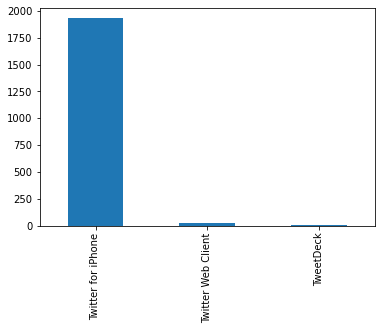

In [94]:
tweet_df['source'].value_counts().plot(kind='bar')

### 3. See the we rate dog tweets with more engagements

In [95]:
#create a total engagement column so we can get which we rate dogs tweet got more reactions from fans
tweet_df['total_engagement'] = tweet_df['retweet_count'] + tweet_df['favorite_count']

In [96]:
# Using sort values to see which dog has the most engagements
tweet_df.sort_values(['total_engagement'], ascending=False)

,tweet_id,timestamp,source,text,expanded_urls,name,dog_stages,ratings,retweet_count,favorite_count,jpg_url,img_num,prediction_1,p1_confidence,p1_dog,prediction_2,p2_confidence,p2_dog,prediction_3,p3_confidence,p3_dog,total_engagement
762,744234799360020481,2016-06-18 18:26:18+00:00,Twitter for iPhone,Here's a doggo realizing you can stand in a pool. 13/10 enlightened af (vid by Tina Conrad) https://t.co/7wE9LTEXC4,https://twitter.com/dog_rates/status/744234799360020481/video/1,Unknown,doggo,1.3,70811,144912,https://pbs.twimg.com/ext_tw_video_thumb/744234667679821824/pu/img/1GaWmtJtdqzZV7jy.jpg,1,Labrador Retriever,0.825333,True,Ice Bear,4.468080e-02,False,Whippet,1.844220e-02,True,215723
305,822872901745569793,2017-01-21 18:26:02+00:00,Twitter for iPhone,Here's a super supportive puppo participating in the Toronto #WomensMarch today. 13/10 https://t.co/nTz3FtorBc,https://twitter.com/dog_rates/status/822872901745569793/photo/1,Unknown,puppo,1.3,39959,124096,https://pbs.twimg.com/media/C2tugXLXgAArJO4.jpg,1,Lakeland Terrier,0.196015,True,Labrador Retriever,1.603290e-01,True,Irish Terrier,6.912620e-02,True,164055
394,807106840509214720,2016-12-09 06:17:20+00:00,Twitter for iPhone,This is Stephan. He just wants to help. 13/10 such a good boy https://t.co/DkBYaCAg2d,https://twitter.com/dog_rates/status/807106840509214720/video/1,Stephan,NaN,1.3,51731,111702,https://pbs.twimg.com/ext_tw_video_thumb/807106774843039744/pu/img/8XZg1xW35Xp2J6JW.jpg,1,Chihuahua,0.505370,True,Pomeranian,1.203580e-01,True,Toy Terrier,7.700810e-02,True,163433
797,739238157791694849,2016-06-04 23:31:25+00:00,Twitter for iPhone,Here's a doggo blowing bubbles. It's downright legendary. 13/10 would watch on repeat forever (vid by Kent Duryee) https://t.co/YcXgHfp1EC,https://twitter.com/dog_rates/status/739238157791694849/video/1,Unknown,doggo,1.3,52952,107266,https://pbs.twimg.com/ext_tw_video_thumb/739238016737267712/pu/img/-tLpyiuIzD5zR1et.jpg,1,Eskimo Dog,0.503372,True,Siberian Husky,3.904130e-01,True,Malamute,8.090120e-02,True,160218
107,866450705531457537,2017-05-22 00:28:40+00:00,Twitter for iPhone,"This is Jamesy. He gives a kiss to every other pupper he sees on his walk. 13/10 such passion, much tender https://t.co/wk7TfysWHr",https://twitter.com/dog_rates/status/866450705531457537/photo/1,Jamesy,pupper,1.3,30235,108921,https://pbs.twimg.com/media/DAZAUfBXcAAG_Nn.jpg,2,French Bulldog,0.905334,True,Boston Bull,7.805970e-02,True,Pug,1.770920e-03,True,139156
58,879415818425184262,2017-06-26 19:07:24+00:00,Twitter for iPhone,This is Duddles. He did an attempt. 13/10 someone help him (vid by Georgia Felici) https://t.co/UDT7ZkcTgY,https://twitter.com/dog_rates/status/879415818425184262/video/1,Duddles,NaN,1.3,37432,92881,https://pbs.twimg.com/ext_tw_video_thumb/879415784908390401/pu/img/cX7XI1TnUsseGET5.jpg,1,English Springer,0.383404,True,Boston Bull,1.349670e-01,True,Cardigan,1.104810e-01,True,130313
328,819004803107983360,2017-01-11 02:15:36+00:00,Twitter for iPhone,This is Bo. He was a very good First Doggo. 14/10 would be an absolute honor to pet https://t.co/AdPKrI8BZ1,https://twitter.com/dog_rates/status/819004803107983360/photo/1,Bo,doggo,1.4,34573,82677,https://pbs.twimg.com/media/C12whDoVEAALRxa.jpg,1,Standard Poodle,0.351308,True,Toy Poodle,2.719290e-01,True,Tibetan Terrier,9.475920e-02,True,117250
134,859196978902773760,2017-05-02 00:04:57+00:00,Twitter for iPhone,We only rate dogs. This is quite clearly a smol broken polar bear. We'd appreciate if you only send dogs. Thank you... 12/10 https://t.co/g2nSyGenG9,https://twitter.com/dog_rates/status/859196978902773760/video/1,quite,NaN,1.2,26314,80486,https://pbs.twimg.com/ext_tw_video_thumb/859196962498805762/pu/img/-yBpr4-o4GJZECYE.jpg,1,Angora,0.224218,False,Malamute,2.161630e-01,True,Persian Cat,1.283830e-01,False,106800
396,806629075125202948,2016-12-07 22:38:52+00:00,Twitter for iPhone,"""Good afternoon class today we're going to learn what makes a good boy so good"" 13/10 https://t.co/f1h2Fsa

In [97]:
#  Using sort values to see which dog has the most retweets
tweet_df.sort_values(['retweet_count'], ascending=False)

,tweet_id,timestamp,source,text,expanded_urls,name,dog_stages,ratings,retweet_count,favorite_count,jpg_url,img_num,prediction_1,p1_confidence,p1_dog,prediction_2,p2_confidence,p2_dog,prediction_3,p3_confidence,p3_dog,total_engagement
762,744234799360020481,2016-06-18 18:26:18+00:00,Twitter for iPhone,Here's a doggo realizing you can stand in a pool. 13/10 enlightened af (vid by Tina Conrad) https://t.co/7wE9LTEXC4,https://twitter.com/dog_rates/status/744234799360020481/video/1,Unknown,doggo,1.3,70811,144912,https://pbs.twimg.com/ext_tw_video_thumb/744234667679821824/pu/img/1GaWmtJtdqzZV7jy.jpg,1,Labrador Retriever,0.825333,True,Ice Bear,4.468080e-02,False,Whippet,1.844220e-02,True,215723
797,739238157791694849,2016-06-04 23:31:25+00:00,Twitter for iPhone,Here's a doggo blowing bubbles. It's downright legendary. 13/10 would watch on repeat forever (vid by Kent Duryee) https://t.co/YcXgHfp1EC,https://twitter.com/dog_rates/status/739238157791694849/video/1,Unknown,doggo,1.3,52952,107266,https://pbs.twimg.com/ext_tw_video_thumb/739238016737267712/pu/img/-tLpyiuIzD5zR1et.jpg,1,Eskimo Dog,0.503372,True,Siberian Husky,3.904130e-01,True,Malamute,8.090120e-02,True,160218
394,807106840509214720,2016-12-09 06:17:20+00:00,Twitter for iPhone,This is Stephan. He just wants to help. 13/10 such a good boy https://t.co/DkBYaCAg2d,https://twitter.com/dog_rates/status/807106840509214720/video/1,Stephan,NaN,1.3,51731,111702,https://pbs.twimg.com/ext_tw_video_thumb/807106774843039744/pu/img/8XZg1xW35Xp2J6JW.jpg,1,Chihuahua,0.505370,True,Pomeranian,1.203580e-01,True,Toy Terrier,7.700810e-02,True,163433
305,822872901745569793,2017-01-21 18:26:02+00:00,Twitter for iPhone,Here's a super supportive puppo participating in the Toronto #WomensMarch today. 13/10 https://t.co/nTz3FtorBc,https://twitter.com/dog_rates/status/822872901745569793/photo/1,Unknown,puppo,1.3,39959,124096,https://pbs.twimg.com/media/C2tugXLXgAArJO4.jpg,1,Lakeland Terrier,0.196015,True,Labrador Retriever,1.603290e-01,True,Irish Terrier,6.912620e-02,True,164055
58,879415818425184262,2017-06-26 19:07:24+00:00,Twitter for iPhone,This is Duddles. He did an attempt. 13/10 someone help him (vid by Georgia Felici) https://t.co/UDT7ZkcTgY,https://twitter.com/dog_rates/status/879415818425184262/video/1,Duddles,NaN,1.3,37432,92881,https://pbs.twimg.com/ext_tw_video_thumb/879415784908390401/pu/img/cX7XI1TnUsseGET5.jpg,1,English Springer,0.383404,True,Boston Bull,1.349670e-01,True,Cardigan,1.104810e-01,True,130313
328,819004803107983360,2017-01-11 02:15:36+00:00,Twitter for iPhone,This is Bo. He was a very good First Doggo. 14/10 would be an absolute honor to pet https://t.co/AdPKrI8BZ1,https://twitter.com/dog_rates/status/819004803107983360/photo/1,Bo,doggo,1.4,34573,82677,https://pbs.twimg.com/media/C12whDoVEAALRxa.jpg,1,Standard Poodle,0.351308,True,Toy Poodle,2.719290e-01,True,Tibetan Terrier,9.475920e-02,True,117250
396,806629075125202948,2016-12-07 22:38:52+00:00,Twitter for iPhone,"""Good afternoon class today we're going to learn what makes a good boy so good"" 13/10 https://t.co/f1h2Fsalv9",https://twitter.com/dog_rates/status/806629075125202948/photo/1,Unknown,NaN,1.3,32424,70658,https://pbs.twimg.com/media/CzG425nWgAAnP7P.jpg,2,Arabian Camel,0.366248,False,House Finch,2.098520e-01,False,Cocker Spaniel,4.640320e-02,True,103082
107,866450705531457537,2017-05-22 00:28:40+00:00,Twitter for iPhone,"This is Jamesy. He gives a kiss to every other pupper he sees on his walk. 13/10 such passion, much tender https://t.co/wk7TfysWHr",https://twitter.com/dog_rates/status/866450705531457537/photo/1,Jamesy,pupper,1.3,30235,108921,https://pbs.twimg.com/media/DAZAUfBXcAAG_Nn.jpg,2,French Bulldog,0.905334,True,Boston Bull,7.805970e-02,True,Pug,1.770920e-03,True,139156
1401,678399652199309312,2015-12-20 02:20:55+00:00,Twitter for iPhone,This made my day. 12/10 please enjoy https://t.co/VRTbo3aAcm,https://twitter.com/dog_rates/status/678399652199309312/video/1,Unknown,NaN,1.2,28627,73520,https://pbs.twi

In [98]:
# Using sort values to see which dog has the most favorite counts
tweet_df.sort_values(['favorite_count'], ascending=False)

,tweet_id,timestamp,source,text,expanded_urls,name,dog_stages,ratings,retweet_count,favorite_count,jpg_url,img_num,prediction_1,p1_confidence,p1_dog,prediction_2,p2_confidence,p2_dog,prediction_3,p3_confidence,p3_dog,total_engagement
762,744234799360020481,2016-06-18 18:26:18+00:00,Twitter for iPhone,Here's a doggo realizing you can stand in a pool. 13/10 enlightened af (vid by Tina Conrad) https://t.co/7wE9LTEXC4,https://twitter.com/dog_rates/status/744234799360020481/video/1,Unknown,doggo,1.3,70811,144912,https://pbs.twimg.com/ext_tw_video_thumb/744234667679821824/pu/img/1GaWmtJtdqzZV7jy.jpg,1,Labrador Retriever,0.825333,True,Ice Bear,4.468080e-02,False,Whippet,1.844220e-02,True,215723
305,822872901745569793,2017-01-21 18:26:02+00:00,Twitter for iPhone,Here's a super supportive puppo participating in the Toronto #WomensMarch today. 13/10 https://t.co/nTz3FtorBc,https://twitter.com/dog_rates/status/822872901745569793/photo/1,Unknown,puppo,1.3,39959,124096,https://pbs.twimg.com/media/C2tugXLXgAArJO4.jpg,1,Lakeland Terrier,0.196015,True,Labrador Retriever,1.603290e-01,True,Irish Terrier,6.912620e-02,True,164055
394,807106840509214720,2016-12-09 06:17:20+00:00,Twitter for iPhone,This is Stephan. He just wants to help. 13/10 such a good boy https://t.co/DkBYaCAg2d,https://twitter.com/dog_rates/status/807106840509214720/video/1,Stephan,NaN,1.3,51731,111702,https://pbs.twimg.com/ext_tw_video_thumb/807106774843039744/pu/img/8XZg1xW35Xp2J6JW.jpg,1,Chihuahua,0.505370,True,Pomeranian,1.203580e-01,True,Toy Terrier,7.700810e-02,True,163433
107,866450705531457537,2017-05-22 00:28:40+00:00,Twitter for iPhone,"This is Jamesy. He gives a kiss to every other pupper he sees on his walk. 13/10 such passion, much tender https://t.co/wk7TfysWHr",https://twitter.com/dog_rates/status/866450705531457537/photo/1,Jamesy,pupper,1.3,30235,108921,https://pbs.twimg.com/media/DAZAUfBXcAAG_Nn.jpg,2,French Bulldog,0.905334,True,Boston Bull,7.805970e-02,True,Pug,1.770920e-03,True,139156
797,739238157791694849,2016-06-04 23:31:25+00:00,Twitter for iPhone,Here's a doggo blowing bubbles. It's downright legendary. 13/10 would watch on repeat forever (vid by Kent Duryee) https://t.co/YcXgHfp1EC,https://twitter.com/dog_rates/status/739238157791694849/video/1,Unknown,doggo,1.3,52952,107266,https://pbs.twimg.com/ext_tw_video_thumb/739238016737267712/pu/img/-tLpyiuIzD5zR1et.jpg,1,Eskimo Dog,0.503372,True,Siberian Husky,3.904130e-01,True,Malamute,8.090120e-02,True,160218
58,879415818425184262,2017-06-26 19:07:24+00:00,Twitter for iPhone,This is Duddles. He did an attempt. 13/10 someone help him (vid by Georgia Felici) https://t.co/UDT7ZkcTgY,https://twitter.com/dog_rates/status/879415818425184262/video/1,Duddles,NaN,1.3,37432,92881,https://pbs.twimg.com/ext_tw_video_thumb/879415784908390401/pu/img/cX7XI1TnUsseGET5.jpg,1,English Springer,0.383404,True,Boston Bull,1.349670e-01,True,Cardigan,1.104810e-01,True,130313
328,819004803107983360,2017-01-11 02:15:36+00:00,Twitter for iPhone,This is Bo. He was a very good First Doggo. 14/10 would be an absolute honor to pet https://t.co/AdPKrI8BZ1,https://twitter.com/dog_rates/status/819004803107983360/photo/1,Bo,doggo,1.4,34573,82677,https://pbs.twimg.com/media/C12whDoVEAALRxa.jpg,1,Standard Poodle,0.351308,True,Toy Poodle,2.719290e-01,True,Tibetan Terrier,9.475920e-02,True,117250
134,859196978902773760,2017-05-02 00:04:57+00:00,Twitter for iPhone,We only rate dogs. This is quite clearly a smol broken polar bear. We'd appreciate if you only send dogs. Thank you... 12/10 https://t.co/g2nSyGenG9,https://twitter.com/dog_rates/status/859196978902773760/video/1,quite,NaN,1.2,26314,80486,https://pbs.twimg.com/ext_tw_video_thumb/859196962498805762/pu/img/-yBpr4-o4GJZECYE.jpg,1,Angora,0.224218,False,Malamute,2.161630e-01,True,Persian Cat,1.283830e-01,False,106800
92,870374049280663552,2017-06-01 20:18:38+00:00,Twitter for iPhone,This is Zoey. She really likes the planet. Would hate to see willful ignorance and the denial of fairly elemen

In [99]:
#  Using sort values to see which dog has the highest ratings
tweet_df.sort_values(['ratings'], ascending=False)

,tweet_id,timestamp,source,text,expanded_urls,name,dog_stages,ratings,retweet_count,favorite_count,jpg_url,img_num,prediction_1,p1_confidence,p1_dog,prediction_2,p2_confidence,p2_dog,prediction_3,p3_confidence,p3_dog,total_engagement
49,881536004380872706,2017-07-02 15:32:16+00:00,Twitter for iPhone,Here is a pupper approaching maximum borkdrive. Zooming at never before seen speeds. 14/10 paw-inspiring af \n(IG: puffie_the_chow) https://t.co/ghXBIIeQZF,https://twitter.com/dog_rates/status/881536004380872706/video/1,Unknown,pupper,1.4,13408,43462,https://pbs.twimg.com/ext_tw_video_thumb/881535971568889856/pu/img/9bawiZ--8FKywTkz.jpg,1,Samoyed,0.281463,True,Angora,2.720660e-01,False,Persian Cat,1.148540e-01,False,56870
64,878057613040115712,2017-06-23 01:10:23+00:00,Twitter for iPhone,This is Emmy. She was adopted today. Massive round of pupplause for Emmy and her new family. 14/10 for all involved https://t.co/cwtWnHMVpe,https://twitter.com/dog_rates/status/878057613040115712/photo/1,Emmy,NaN,1.4,5746,37148,https://pbs.twimg.com/media/DC98vABUIAA97pz.jpg,1,French Bulldog,0.839097,True,Boston Bull,7.879940e-02,True,Toy Terrier,1.524340e-02,True,42894
36,884441805382717440,2017-07-10 15:58:53+00:00,Twitter for iPhone,"I present to you, Pup in Hat. Pup in Hat is great for all occasions. Extremely versatile. Compact as h*ck. 14/10 (IG: itselizabethgales) https://t.co/vvBOcC2VdC",https://twitter.com/dog_rates/status/884441805382717440/photo/1,Unknown,NaN,1.4,4793,23868,https://pbs.twimg.com/media/DEYrIZwWsAA2Wo5.jpg,1,Pembroke,0.993225,True,Cardigan,3.216480e-03,True,Chihuahua,2.080890e-03,True,28661
670,755206590534418437,2016-07-19 01:04:16+00:00,Twitter for iPhone,This is one of the most inspirational stories I've ever come across. I have no words. 14/10 for both doggo and owner https://t.co/I5ld3eKD5k,https://twitter.com/dog_rates/status/755206590534418437/photo/1,one,doggo,1.4,4919,15315,https://pbs.twimg.com/media/CnsIT0WWcAAul8V.jpg,1,Web Site,0.906673,False,Printer,8.600270e-03,False,Carton,4.533190e-03,False,20234
146,856282028240666624,2017-04-23 23:01:59+00:00,Twitter for iPhone,"This is Cermet, Paesh, and Morple. They are absolute h*ckin superstars. Watered every day so they can grow. 14/10 for all https://t.co/GUefqUmZv8",https://twitter.com/dog_rates/status/856282028240666624/photo/1,Cermet,NaN,1.4,5587,25253,https://pbs.twimg.com/media/C-If9ZwXoAAfDX2.jpg,4,Chihuahua,0.876543,True,Italian Greyhound,3.296180e-02,True,Cardigan,2.077590e-02,True,30840
562,774314403806253056,2016-09-09 18:31:54+00:00,Twitter for iPhone,I WAS SENT THE ACTUAL DOG IN THE PROFILE PIC BY HIS OWNER THIS IS SO WILD. 14/10 ULTIMATE LEGEND STATUS https://t.co/7oQ1wpfxIH,https://twitter.com/dog_rates/status/774314403806253056/photo/1,Unknown,NaN,1.4,5094,20565,https://pbs.twimg.com/media/Cr7q1VxWIAA5Nm7.jpg,3,Eskimo Dog,0.596045,True,Siberian Husky,2.230670e-01,True,Saluki,3.632470e-02,True,25659
145,856526610513747968,2017-04-24 15:13:52+00:00,Twitter for iPhone,"THIS IS CHARLIE, MARK. HE DID JUST WANT TO SAY HI AFTER ALL. PUPGRADED TO A 14/10. WOULD BE AN HONOR TO FLY WITH https://t.co/p1hBHCmWnA",https://twitter.com/dog_rates/status/856526610513747968/photo/1,Unknown,NaN,1.4,1656,10842,https://pbs.twimg.com/media/C-L-aIYXgAIR0jY.jpg,1,Old English Sheepdog,0.798481,True,Tibetan Terrier,6.060240e-02,True,Standard Poodle,4.072190e-02,True,12498
99,868880397819494401,2017-05-28 17:23:24+00:00,Twitter for iPhone,This is Walter. He won't start hydrotherapy without his favorite floatie. 14/10 keep it pup Walter https://t.co/r28jFx9uyF,https://twitter.com/dog_rates/status/868880397819494401/photo/1,Walter,NaN,1.4,12270,57985,https://pbs.twimg.com/media/DA7iHL5U0AA1OQo.jpg,1,Laptop,0.153718,False,French Bulldog,9.998390e-02,True,Printer,7.712990e-02,False,70255
250,832273440279240704,2017-02-16 17:00:25+00:00,Twitter for iPhone,Say hello to Smiley. He's a blind therapy doggo having a h*ckin blast high steppin around in the snow. 14/10 would follow anywhe

In [100]:
tweet_df.iloc[49]

tweet_id            881536004380872706                                                                                                                                         
timestamp           2017-07-02 15:32:16+00:00                                                                                                                                  
source              Twitter for iPhone                                                                                                                                         
text                Here is a pupper approaching maximum borkdrive. Zooming at never before seen speeds. 14/10 paw-inspiring af \n(IG: puffie_the_chow) https://t.co/ghXBIIeQZF
expanded_urls       https://twitter.com/dog_rates/status/881536004380872706/video/1                                                                                            
name                Unknown                                                                                             

### 4. See the most featured dog stage in the dataset

In [101]:
tweet_df['dog_stages'].value_counts()

pupper     202
doggo      73 
puppo      22 
floofer    7  
Name: dog_stages, dtype: int64

<AxesSubplot:>

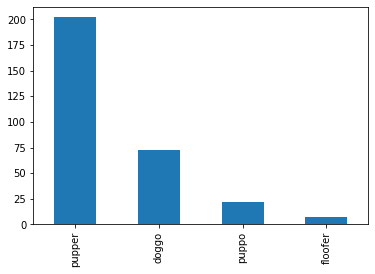

In [102]:
tweet_df['dog_stages'].value_counts().plot(kind='bar')

### 5. See numbers of times a particular breed was predicted in all threee predictions

In [103]:
#prediction 1
tweet_df.groupby('prediction_1')['p1_dog'].size().sort_values(ascending=False)

prediction_1
Golden Retriever                  136
Labrador Retriever                89 
Pembroke                          88 
Chihuahua                         79 
Pug                               54 
Chow                              41 
Samoyed                           39 
Pomeranian                        37 
Toy Poodle                        37 
Malamute                          29 
Cocker Spaniel                    27 
French Bulldog                    25 
Chesapeake Bay Retriever          23 
Miniature Pinscher                22 
Seat Belt                         21 
Siberian Husky                    20 
German Shepherd                   20 
Staffordshire Bullterrier         18 
Maltese Dog                       18 
Shetland Sheepdog                 18 
Eskimo Dog                        18 
Teddy                             17 
Beagle                            17 
Cardigan                          17 
Shih-Tzu                          17 
Rottweiler                        17 

In [104]:
# prediction 2
tweet_df.groupby('prediction_2')['p2_dog'].size().sort_values(ascending=False)

prediction_2
Labrador Retriever                96
Golden Retriever                  79
Cardigan                          73
Chihuahua                         42
Chesapeake Bay Retriever          40
French Bulldog                    39
Pomeranian                        39
Toy Poodle                        36
Siberian Husky                    33
Miniature Poodle                  32
Cocker Spaniel                    29
Beagle                            28
Eskimo Dog                        27
Collie                            26
Pembroke                          25
Kuvasz                            22
Italian Greyhound                 22
Pekinese                          21
Malinois                          20
Chow                              20
Miniature Pinscher                20
Norwegian Elkhound                19
American Staffordshire Terrier    19
Toy Terrier                       19
Boston Bull                       18
Pug                               17
Staffordshire Bullterrier

In [105]:
# prediction 3
tweet_df.groupby('prediction_3')['p3_dog'].size().sort_values(ascending=False)

prediction_3
Labrador Retriever                75
Chihuahua                         57
Golden Retriever                  45
Eskimo Dog                        36
Kelpie                            33
Kuvasz                            31
Staffordshire Bullterrier         30
Beagle                            29
Toy Poodle                        29
Chow                              29
Cocker Spaniel                    28
Pekinese                          28
Pembroke                          26
Pomeranian                        26
Malamute                          25
French Bulldog                    25
Great Pyrenees                    24
Cardigan                          23
Chesapeake Bay Retriever          22
American Staffordshire Terrier    22
Basenji                           20
Siberian Husky                    19
Bull Mastiff                      19
Pug                               19
Toy Terrier                       18
Shetland Sheepdog                 17
Boston Bull              

### 6. The relationship btw the dog stages and the engagements the tweets got

In [106]:
df = tweet_df.groupby('dog_stages').sum()[['retweet_count','favorite_count','total_engagement']]

<AxesSubplot:xlabel='dog_stages'>

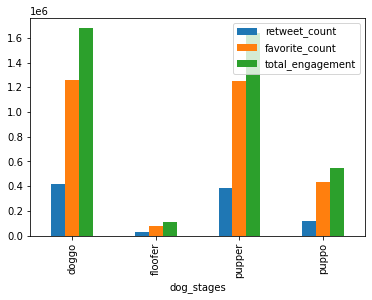

In [107]:
df.plot(kind='bar')

### Insights:
1. The popular dog names of dogs in the we rate dogs archive data are Oliver, Cooper and Charlie, each names have 10 dogs bearing them.

2. The Image prediction data predicted that a dog breed would be Golden Retriver and Labrador retriever more than any other breeds

3. Most of the tweets made in the we rate dogs timeline were done using an Iphone

### Visualization

###  The relationship btw the dog stages and the engagements the tweets got

In [108]:
df = tweet_df.groupby('dog_stages').sum()[['retweet_count','favorite_count','total_engagement']]

<AxesSubplot:xlabel='dog_stages'>

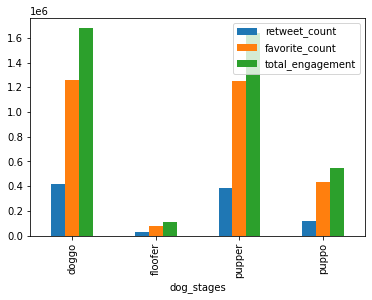

In [109]:
df.plot(kind='bar')